# Flood Fill Tutorial 
This notebook will run through an example of how to use Flood Fill and what output to expect at each part. The process is broken into three parts. 

<ol> 
    <li>Spike Detection</li>
    <li>Waveform Clustering</li>
    <li>Bayesian Optimal Template Matching </li>
</ol>  

This notebook will only cover the first two steps. At each part, the input, the process, the output, and the class structure will be defined as well as any important functions available to the user. Below is a diagram giving a visual explanation of the process


# 1. Spike Detection

<h2> Constructing a Flood Fill Object</h2>
    
<p>For spike detection, we will utilize the flood fill algorithm. The flood fill algorithm is encapsulated in flood.py as an object. The constructor of the object takes in the following:</p>
    
<ol>
    <li>Data (Time, Channel) </li>
    <li>Adjacency Matrix (2xN)</li>
</ol>  
    
<p>We construct the flood fill object below by first loading in the data and then constructing the object:</p>


In [1]:
# Necessary imports
import numpy as np
import matplotlib.pyplot as plt 

# Loading in data and adjacency matrix
adj =  np.genfromtxt('Inputs/adj.csv', delimiter=',', dtype=np.int8)
data = np.genfromtxt('Inputs/data.csv', delimiter=',')

In [2]:
# Constructing the flood fill object
import flood

ff = flood.FloodFill(data, adj)

## Detecting spikes with Flood Fill
<p>For using the floodfill object, we detect the spikes using the detect_spikes() method. detect_spikes() takes in a properly constructed floodfill object and populates the spk field in the object as well as returning it. </p>

<p>An example can be seen below:</p>

<p><strong>SPECIAL NOTE</strong>: An optional parameter 'refr' that determines the refractory violation at its default value (refr=30) reaches max recursion depth on the example dataset. We reduce refr to 5 (refr=5) for the sake of this example. </p>

In [3]:
spikes = ff.detect_spikes(refr=5)

/Users/samir/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


## Visualizing spikes with Flood Fill
<p> To visualize the detected spikes, utilize the vis class in which you construct a vis object that takes in a FloodFill object as a paramter through the constructor. </p>

<p> We can visualize individual spikes using the plot_spk() function as seen below </p>

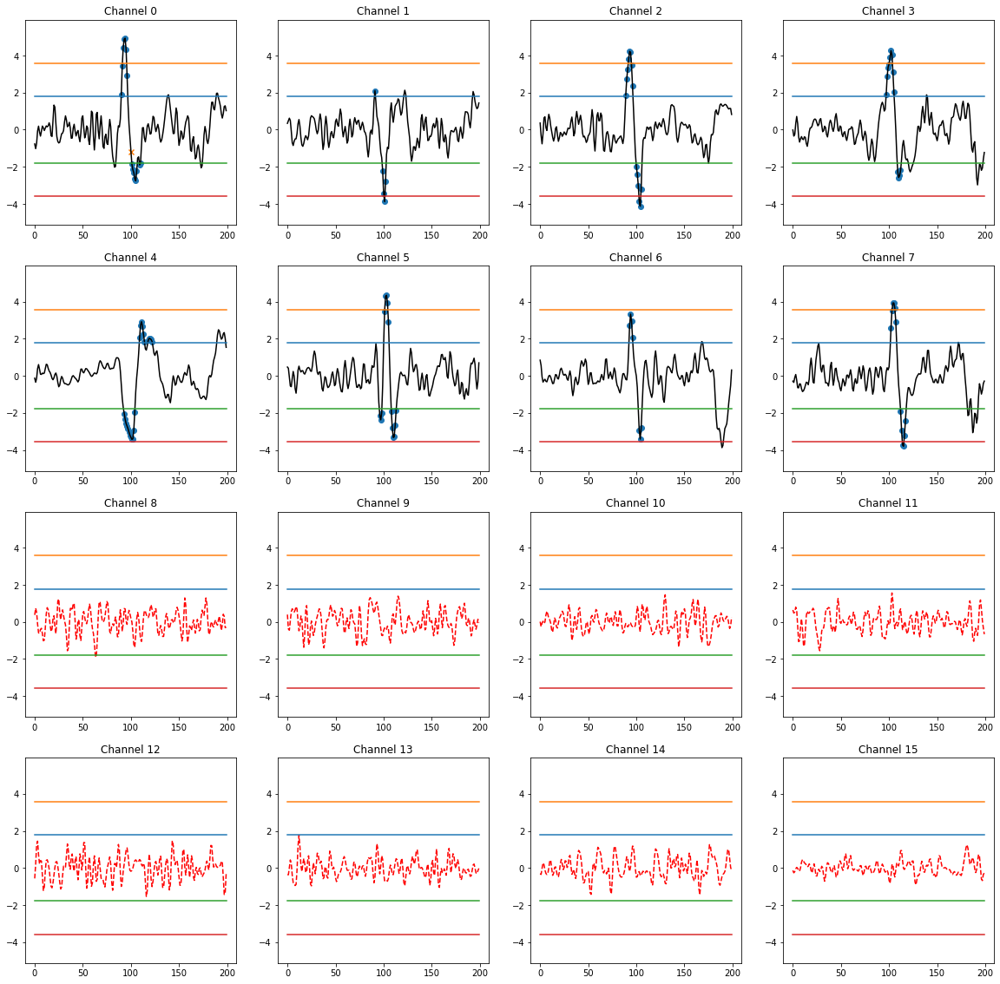

In [4]:
import vis

v = vis.vis(ff)
_ = v.plot_spk(1)

<p> We can also visualize the data with plot_data() </p>

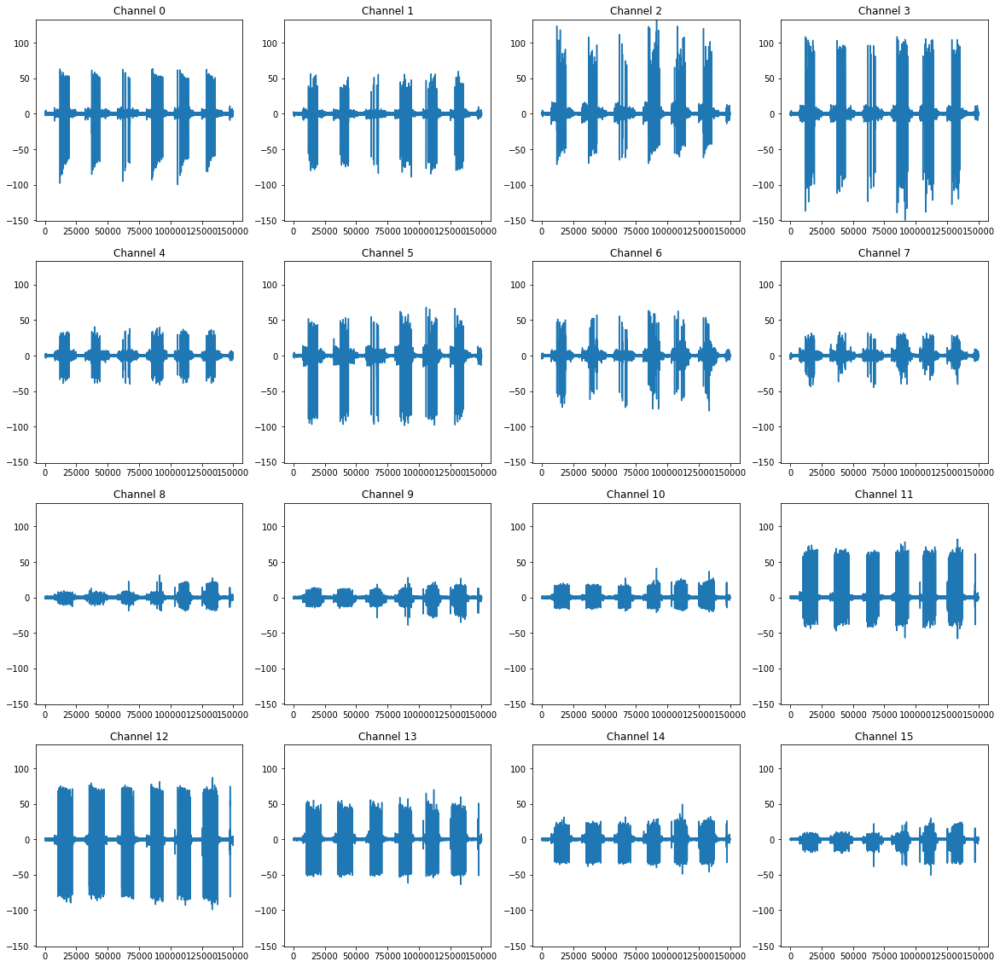

In [5]:
_ = v.plot_data()

# Waveform Generation 

<p> With the detected spikes, we can now generate the waveforms. We generate the waveforms through the class found in waveform.py. It takes in the following as parameters. </p>

<ol>
    <li> Data from flood fill </li>
    <li> Spike times from the flood fill object </li> 
    <li> Spiking channels from the flood fill object </li> 
</ol>

<p> <strong>SPECIAL NOTE</strong>: Only the first column of the spike locations from flood fill are necessarily, and need to be extracted and will be shown below.

In [6]:
# Getting the set of spike channels and spike times
spike_times = ff.spk[0]
spike_channels = [x[:,0] for x in ff.spk[1]]

# Constructing the waveform object 
import waveform
wf = waveform.waveforms(data, spike_times, spike_channels)

In [7]:
# Getting the waveforms 
wf.get_waves(100)

[[0.3003070963369288,
  0.8828483773911754,
  -1.00497369829662,
  -1.3912763002382973,
  0.0592206737264885,
  0.3900255487601788,
  0.03521151778966925,
  -0.9270433833377698,
  0.5358823256731388,
  -0.755146793849848,
  -0.06259542325648713,
  -1.4308543371468838,
  -1.6808886144136754,
  -1.2092354530977183,
  -2.126767744748104,
  -1.7517128287057935,
  0.26400711896097157,
  0.9251019517069972,
  0.1464398305316629,
  0.07613191263804359,
  0.16880844404176604,
  -0.5853497648881839,
  -0.1123077335360531,
  -0.1746246591117461,
  -1.3830859249232317,
  -2.0399203169516387,
  1.0692205936121286,
  -1.0003783781972735,
  -0.5155394701836606,
  0.789034827221222,
  -1.1789179666435967,
  -1.3547925309119695,
  1.995510826758292,
  2.4495357090744427,
  -0.2356072528978892,
  -0.3670231856764888,
  -0.051628547488929484,
  -0.7231333292091593,
  0.20083942586719628,
  -2.457216529185401,
  0.5836637566789118,
  -0.43492207764873014,
  -0.36914923063246496,
  -1.6802745077051255,
  